In [20]:
import ast
import os
import pandas as pd
import random
import time
import torch
import torchvision
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.transforms import functional as TF
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np


In [2]:
def hardware_check():

    if torch.cuda.is_available():
        device = torch.device("cuda")
        print(f"GPU is available!")
        print(f"  -> GPU - {torch.cuda.get_device_name()}")
        print(f"  -> Total Memory: {torch.cuda.get_device_properties().total_memory / 1024**3:.2f} GB")
    else:
        device = torch.device("cpu")
        print("GPU is not available, using CPU.")
        print("\nCPU Information:")

        cpu_model = os.popen("cat /proc/cpuinfo | grep \"model name\" | uniq").read().strip()
        print(f"CPU Model: {cpu_model}")
        print(f"Number of CPU cores: {os.cpu_count()}")

    return device

device = hardware_check()
print(f"\nUsing {device} for computation")

GPU is available!
  -> GPU - NVIDIA RTX 4000 Ada Generation
  -> Total Memory: 19.57 GB

Using cuda for computation


In [3]:
# Percorso locale al dataset
dataset_path = 'CCPD2019' 

if os.path.exists(dataset_path):
    print("Dataset trovato in locale!")
else:
    print(f"Dataset non trovato al percorso: {dataset_path}")


Dataset trovato in locale!


In [ ]:
# Trasformazione per il dataset CCPD

class CCPDTransformCenteredFRCNN:
    def __init__(self, dataset_path, size=(640, 640)):

        self.dataset_path = dataset_path
        self.size = size

    def __call__(self, row):
        image_path = os.path.join(self.dataset_path, row['image_path'])
        if not os.path.isfile(image_path):
            return None

        image = Image.open(image_path).convert("RGB")
        orig_w, orig_h = image.size

        bbox = row['bbox']
        if isinstance(bbox, str):
            bbox = ast.literal_eval(bbox)

        x_min, y_min, x_max, y_max = bbox
        box_cx = (x_min + x_max) / 2
        box_cy = (y_min + y_max) / 2

        # Calcolo del crop quadrato massimo centrato sulla targa
        dist_x = min(box_cx, orig_w - box_cx)
        dist_y = min(box_cy, orig_h - box_cy)
        half_side = min(dist_x, dist_y)

        crop_xmin = int(box_cx - half_side)
        crop_ymin = int(box_cy - half_side)
        crop_xmax = int(box_cx + half_side)
        crop_ymax = int(box_cy + half_side)

        crop = image.crop((crop_xmin, crop_ymin, crop_xmax, crop_ymax))

        # Bbox relativa al crop
        new_x_min = x_min - crop_xmin
        new_y_min = y_min - crop_ymin
        new_x_max = x_max - crop_xmin
        new_y_max = y_max - crop_ymin

        # Conversione crop in tensor
        crop_tensor = TF.to_tensor(crop)

        # Dimensioni crop originali
        crop_h, crop_w = crop_tensor.shape[1:]

        # Ridimensionamento a self.size
        resized_tensor = TF.resize(crop_tensor, self.size, interpolation=Image.BILINEAR)

        scale_x = self.size[1] / crop_w
        scale_y = self.size[0] / crop_h

        # Ridimensionamento bbox
        new_x_min *= scale_x
        new_y_min *= scale_y
        new_x_max *= scale_x
        new_y_max *= scale_y

        # Target nel formato Faster R-CNN
        target = {
            'boxes': torch.tensor([[new_x_min, new_y_min, new_x_max, new_y_max]], dtype=torch.float32),
            'labels': torch.tensor([1], dtype=torch.int64)  # Class id (1 per targa)
        }

        return {
            'image': resized_tensor,
            'target': target
        }


In [10]:
# Augmentation per il dataset CCPD

def apply_random_augmentation_frcnn(sample, aug_prob=0.5):

    image = sample['image']
    target = sample['target']

    _, H, W = image.shape
    boxes = target['boxes']

    # 1. Flip orizzontale
    if random.random() < aug_prob:
        image = F.hflip(image)
        boxes[:, [0, 2]] = W - boxes[:, [2, 0]]  # Vengono invertiti x_min e x_max rispetto alla larghezza

    # 2. Color jitter
    if random.random() < aug_prob:
        color_jitter = transforms.ColorJitter(0.2, 0.2, 0.2, 0.1)
        image = color_jitter(image)

    # 3. Rumore gaussiano
    if random.random() < aug_prob:
        noise = torch.randn_like(image) * 0.02
        image = torch.clamp(image + noise, 0.0, 1.0)

    sample_aug = {
        'image': image,
        'target': {
            'boxes': boxes,
            'labels': target['labels']
        }
    }

    return sample_aug


In [5]:
# Funzione per visualizzare coppie di immagini originali e trasformate con le bounding box

def plot_ccpd_pairs(df, dataset_path, transformer=None, title='Samples', n=3):
    count = 0
    for _, row in df.iterrows():
        image_path = os.path.join(dataset_path, row['image_path'])
        if not os.path.isfile(image_path):
            continue

        image = Image.open(image_path).convert("RGB")
        draw_orig = ImageDraw.Draw(image)

        bbox = row['bbox']
        if isinstance(bbox, str):
            bbox = ast.literal_eval(bbox)
        draw_orig.rectangle(bbox, outline='red', width=3)

        if transformer:
            sample = transformer(row)
            if sample is None:
                continue

            transformed_img = sample['image'].permute(1, 2, 0).cpu()
            transformed_img = torch.clamp(transformed_img, 0, 1).numpy()
            target = sample['target']
            boxes = target['boxes'].cpu().numpy()

            fig, axes = plt.subplots(1, 2, figsize=(12, 6))
            axes[0].imshow(image)
            axes[0].set_title("Original + BBox")

            axes[1].imshow(transformed_img)
            for box in boxes:
                x_min, y_min, x_max, y_max = box
                axes[1].add_patch(plt.Rectangle(
                    (x_min, y_min), x_max - x_min, y_max - y_min,
                    edgecolor='red', facecolor='none', linewidth=2
                ))
            axes[1].set_title("Transformed + BBox")

        else:
            fig, ax = plt.subplots(figsize=(6, 6))
            ax.imshow(image)
            ax.set_title("Original")

        if title:
            fig.suptitle(title, weight='bold')

        plt.tight_layout()
        plt.show()

        count += 1
        if count >= n:
            break


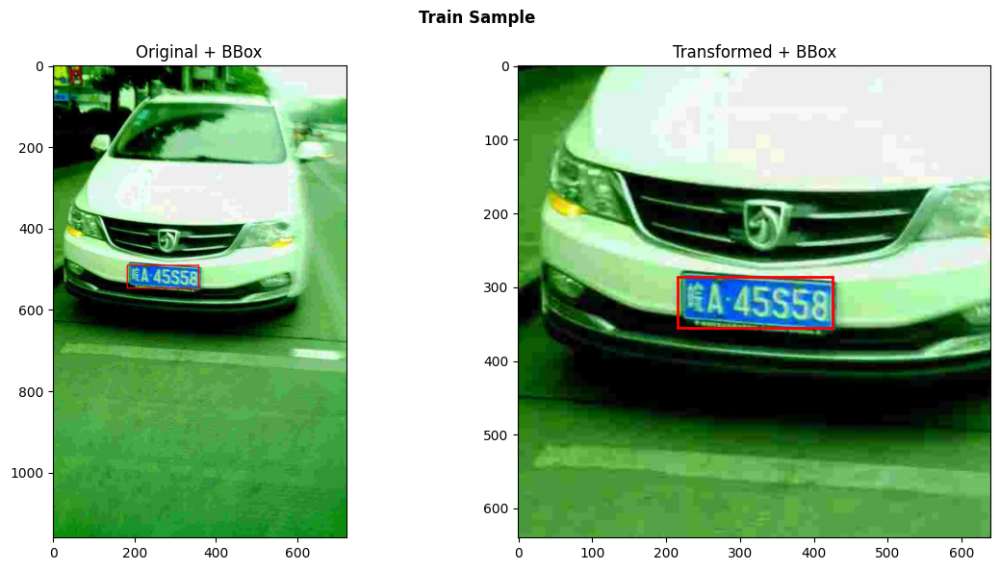

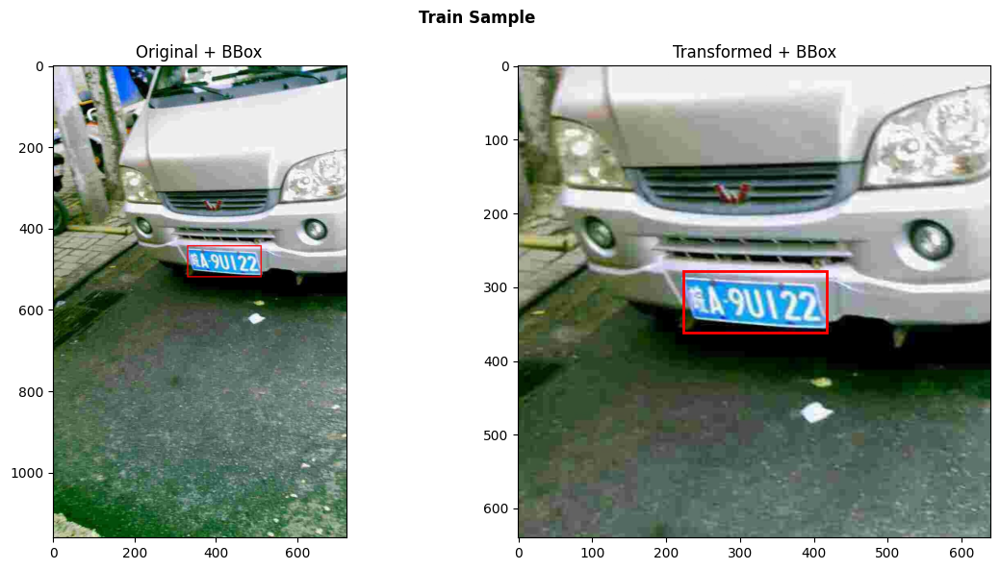

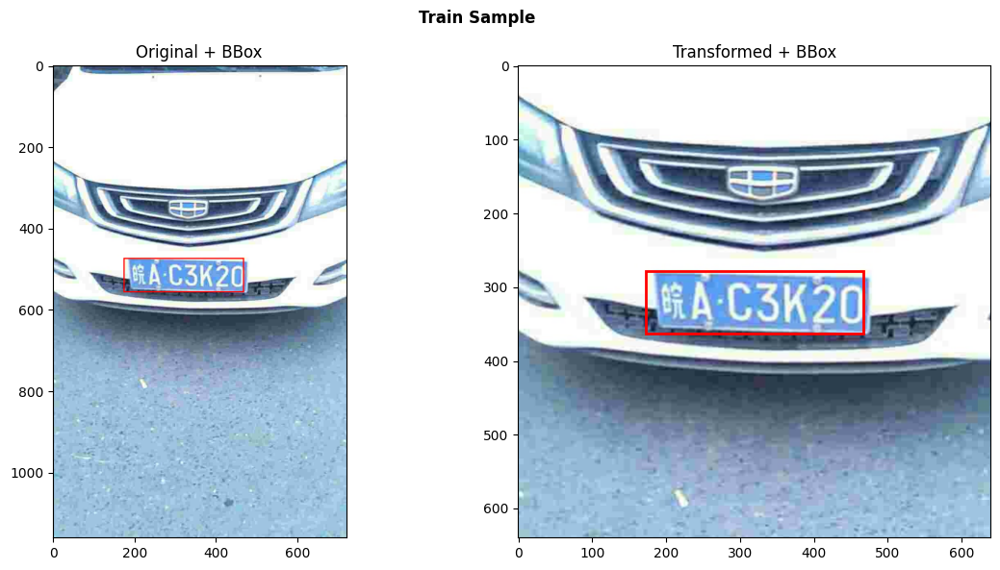

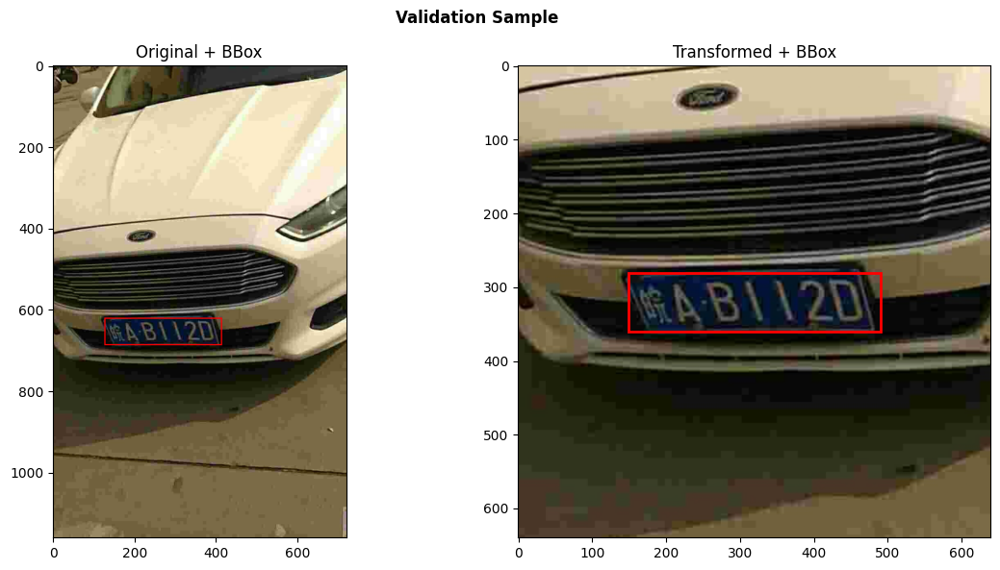

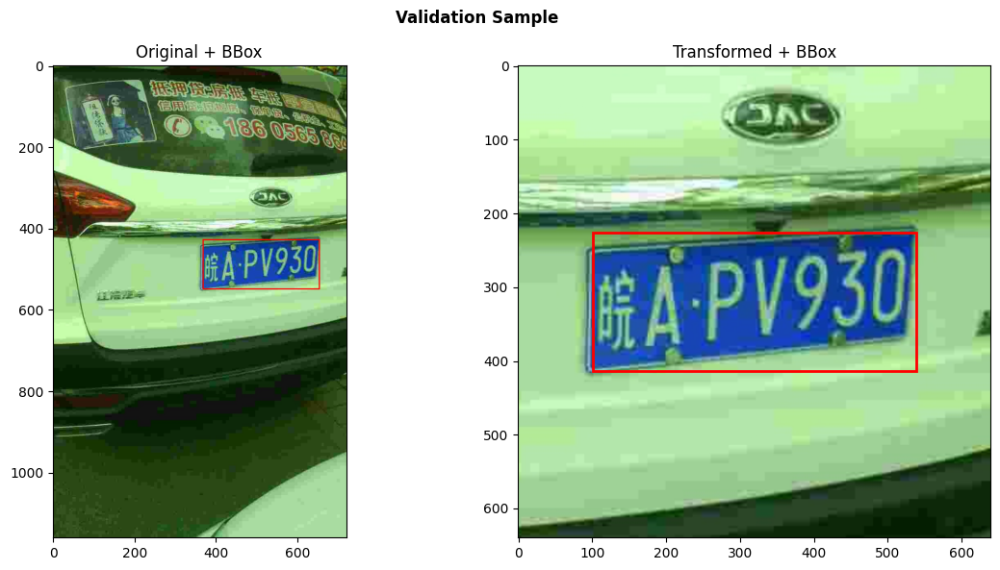

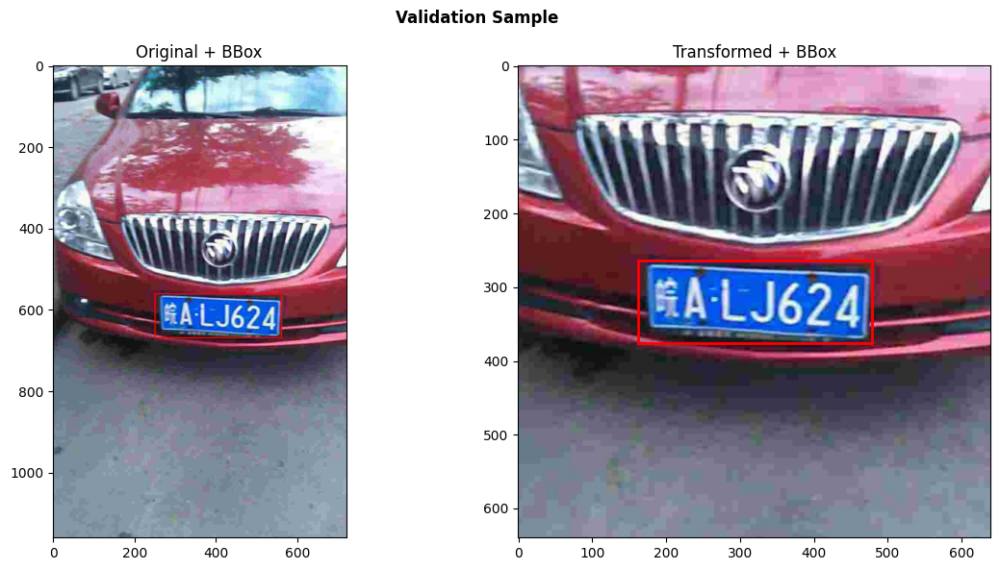

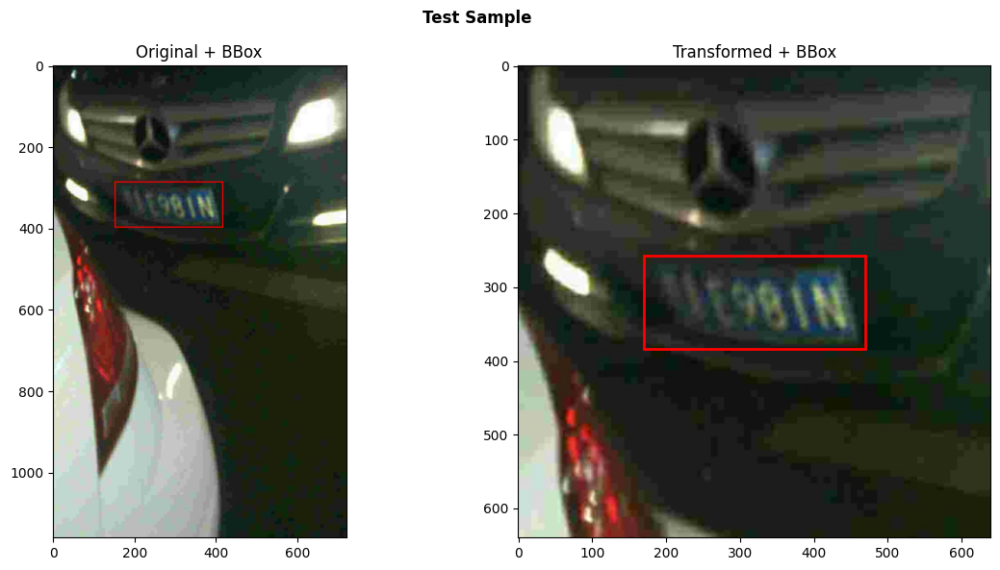

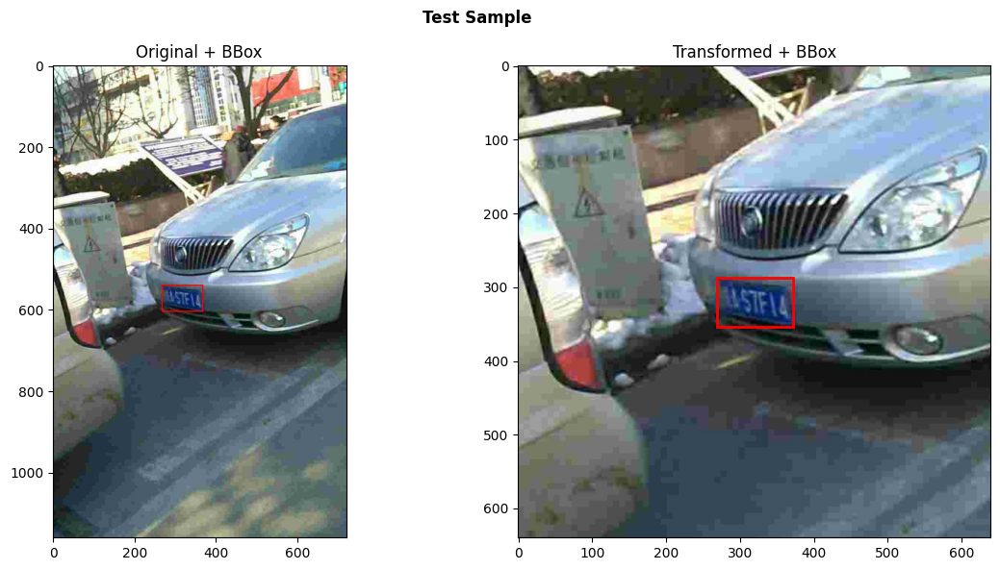

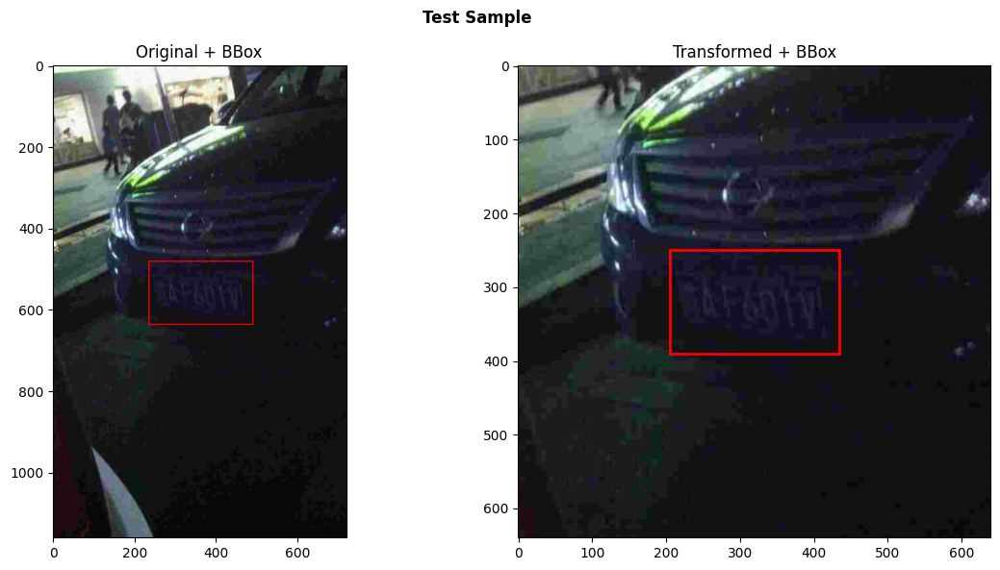

In [6]:
train_df = pd.read_csv("train.csv")
val_df = pd.read_csv("val.csv")
test_df = pd.read_csv("test.csv")

# Primi 3 esempi del train
plot_ccpd_pairs(
    train_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    title="Train Sample",
    n=3
)

# Primi 3 esempi da validation
plot_ccpd_pairs(
    val_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    title="Validation Sample",
    n=3
)

# Primi 3 esempi da test
plot_ccpd_pairs(
    test_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    title="Test Sample",
    n=3
)


In [11]:
# Funzione per visualizzare un esempio del dataset CCPD con bounding box e augmentation (se train)

def plot_first_valid_ccpd_example(df, dataset_path, transformer=None, augment=False, title='Sample'):
    for _, row in df.iterrows():
        image_path = os.path.join(dataset_path, row['image_path'])
        if not os.path.isfile(image_path):
            continue

        image = Image.open(image_path).convert("RGB")
        draw_orig = ImageDraw.Draw(image)
        bbox = row['bbox']
        if isinstance(bbox, str):
            bbox = ast.literal_eval(bbox)
        draw_orig.rectangle(bbox, outline='red', width=3)

        images_to_show = [image]
        titles = ['Original + BBox']

        if transformer:
            sample = transformer(row)
            if sample is None:
                continue

            transformed_img = sample['image']
            transformed_img = torch.clamp(transformed_img, 0, 1)
            transformed_img_pil = transforms.ToPILImage()(transformed_img.cpu())
            target = sample['target']
            boxes = target['boxes'].cpu().numpy()

            draw_transformed = ImageDraw.Draw(transformed_img_pil)
            for box in boxes:
                x_min, y_min, x_max, y_max = box
                draw_transformed.rectangle([x_min, y_min, x_max, y_max], outline='red', width=3)

            images_to_show.append(transformed_img_pil)
            titles.append('Transformed + BBox')

            if augment:
                augmented_sample = apply_random_augmentation_frcnn(sample, aug_prob=1.0)
                aug_img = augmented_sample['image']
                aug_img = torch.clamp(aug_img, 0, 1)
                aug_img_pil = transforms.ToPILImage()(aug_img.cpu())

                target_aug = augmented_sample['target']
                boxes_aug = target_aug['boxes'].cpu().numpy()

                draw_aug = ImageDraw.Draw(aug_img_pil)
                for box in boxes_aug:
                    x_min, y_min, x_max, y_max = box
                    draw_aug.rectangle([x_min, y_min, x_max, y_max], outline='red', width=3)

                images_to_show.append(aug_img_pil)
                titles.append('Augmented + BBox')

        fig, axes = plt.subplots(1, len(images_to_show), figsize=(6 * len(images_to_show), 6))
        if len(images_to_show) == 1:
            axes = [axes]

        for ax, img, ttl in zip(axes, images_to_show, titles):
            ax.imshow(np.array(img))
            ax.set_title(ttl)
            ax.axis('off')

        if title:
            fig.suptitle(title, weight='bold')

        plt.tight_layout()
        plt.show()
        break


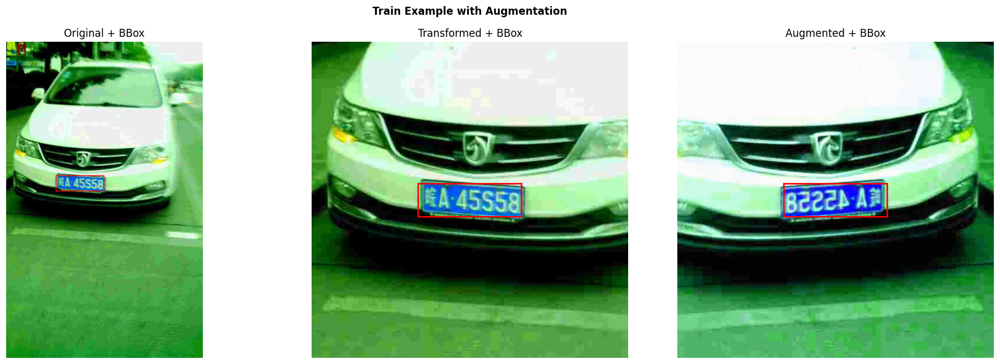

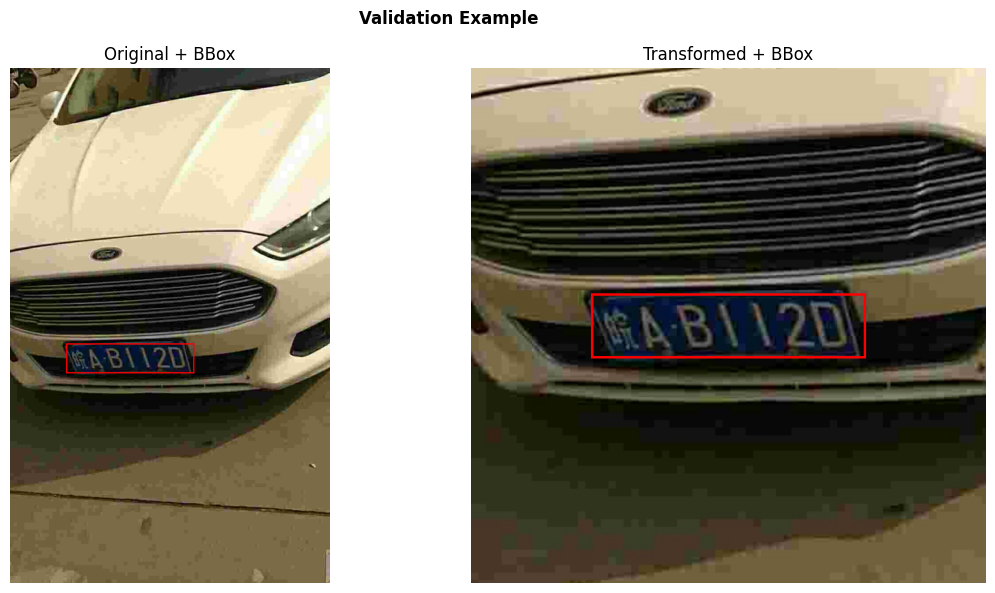

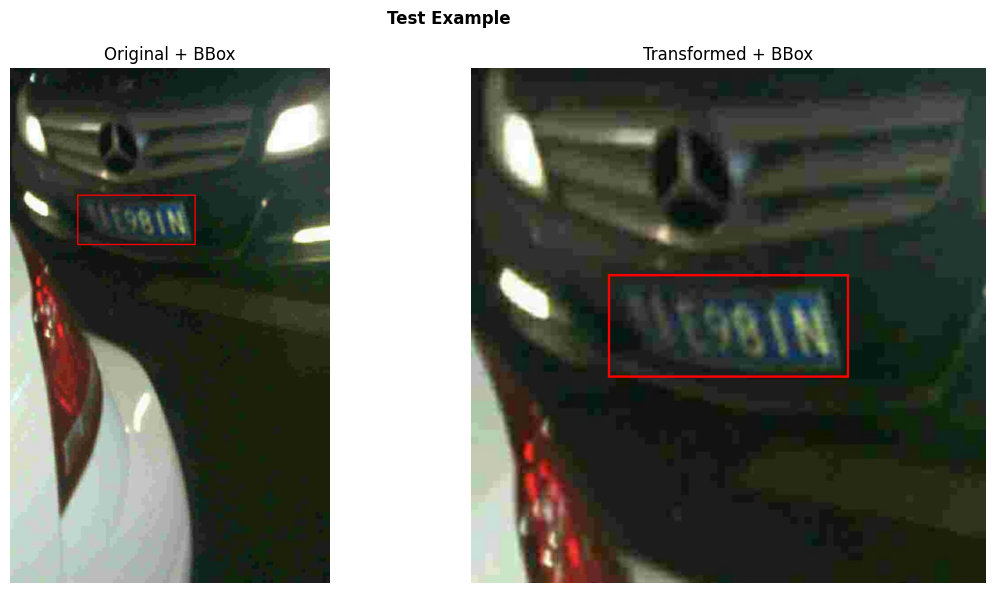

In [14]:
# Primo esempio da train con augmentation attiva
plot_first_valid_ccpd_example(
    train_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    augment=True,
    title="Train Example with Augmentation"
)

# Primo esempio da validation con augmentation disattivata
plot_first_valid_ccpd_example(
    val_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    augment=False,
    title="Validation Example"
)

# Primo esempio da test con augmentation disattivata
plot_first_valid_ccpd_example(
    test_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    augment=False,
    title="Test Example"
)


In [ ]:
# Dataset CCPD per Faster R-CNN

class CCPDFRCNNDataset(Dataset):
    def __init__(self, df, dataset_path, transformer=None, augment=False):

        self.df = df.reset_index(drop=True)
        self.dataset_path = dataset_path
        self.transformer = transformer
        self.augment = augment

    def __getitem__(self, idx):
        row = self.df.iloc[idx]

        # Trasformazione base
        sample = self.transformer(row) if self.transformer else None
        if sample is None:
            return None  

        # Augmentation se richiesta
        if self.augment:
            sample = apply_random_augmentation_frcnn(sample, aug_prob=0.5)

        image = sample['image']
        target = sample['target']

        return image, target

    def __len__(self):
        return len(self.df)


In [16]:
# Funzione di collate per DataLoader (logica di combinazione dei dati in batch)

def collate_fn(batch):
    batch = [b for b in batch if b is not None]
    images, targets = list(zip(*batch))
    return list(images), list(targets)


In [17]:
def get_adaptive_num_workers():

    cpu_count = os.cpu_count()
    if cpu_count is None:
        return 0 
    else:
        return cpu_count

# Uso pratico
num_workers = get_adaptive_num_workers()
print(f"Using num_workers = {num_workers}")


Using num_workers = 8


In [18]:
# TRAIN dataset (con augmentations)
train_dataset = CCPDFRCNNDataset(
    train_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    augment=True
)

# VALIDATION dataset (senza augmentations)
val_dataset = CCPDFRCNNDataset(
    val_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    augment=False
)

# TEST dataset (senza augmentations)
test_dataset = CCPDFRCNNDataset(
    test_df,
    dataset_path,
    transformer=CCPDTransformCenteredFRCNN(dataset_path),
    augment=False
)

train_loader = DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    num_workers=num_workers,
    collate_fn=collate_fn
)

val_loader = DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
    num_workers=num_workers,
    collate_fn=collate_fn
)

test_loader = DataLoader(
    test_dataset,
    batch_size=4,
    shuffle=False,
    num_workers=num_workers,
    collate_fn=collate_fn
)



Checkpoint loaded. Resuming from epoch 15


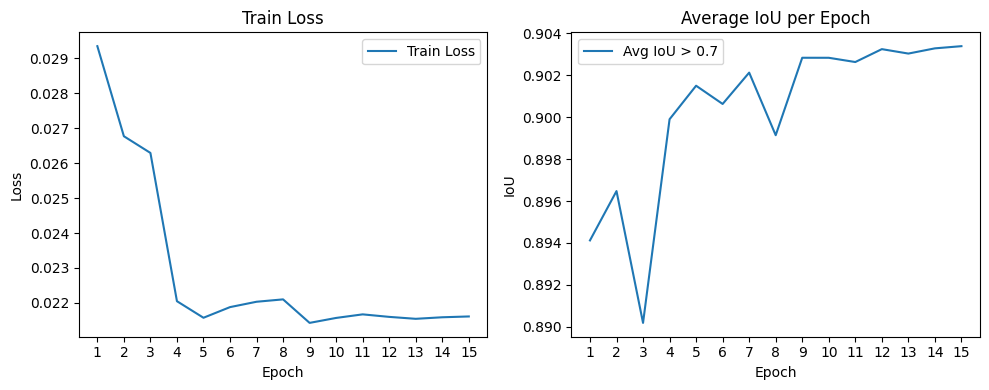

Training on full dataset completed.


In [23]:
# Ciclo di training e validazione per Faster R-CNN

# Parametri di configurazione

num_classes = 2  # background + targa
num_epochs = 15
iou_threshold = 0.7

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Modello FASTER R-CNN

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
model = model.to(device)

# Ottimizzatore e scheduler

params = [p for p in model.parameters() if p.requires_grad]
optimizer = optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# Funzione di calcolo dell'IoU

def compute_iou(box1, box2):
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    inter_area = max(0, x2 - x1) * max(0, y2 - y1)
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])

    union_area = box1_area + box2_area - inter_area
    iou = inter_area / union_area if union_area != 0 else 0
    return iou

# Vengono caricati i checkpoint se esistono, altrimenti si inizia l'allenamento da zero
start_epoch = 0
best_val_iou = 0.0  
try:
    checkpoint = torch.load('checkpoint_full.pth', weights_only=False)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch'] + 1
    best_val_iou = checkpoint.get('best_val_iou', 0.0)

    train_losses = checkpoint.get('train_losses', [])
    avg_ious = checkpoint.get('avg_ious', [])

    print(f"Checkpoint loaded. Resuming from epoch {start_epoch}")
except FileNotFoundError:
    print("No checkpoint found, starting from scratch.")
    train_losses = []
    avg_ious = []


# Training e Validazione

for epoch in range(start_epoch, num_epochs):
    model.train()
    total_loss = 0
    epoch_start = time.time()
    print(f"Starting Epoch {epoch+1}")

    train_loader_tqdm = tqdm(train_loader, desc=f"Epoch {epoch+1} [Train]", leave=False)
    for images, targets in train_loader_tqdm:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
        train_loader_tqdm.set_postfix(loss=losses.item())

    avg_loss = total_loss / len(train_loader)
    train_losses.append(avg_loss)
    epoch_time = time.time() - epoch_start
    print(f"Epoch {epoch+1} completed | Avg Loss: {avg_loss:.4f} | Time: {epoch_time:.2f}s")

    scheduler.step()


    model.eval()
    total_iou = 0
    num_boxes = 0
    val_start = time.time()
    print(f"Starting Validation Epoch {epoch+1}")

    val_loader_tqdm = tqdm(val_loader, desc=f"Epoch {epoch+1} [Val]", leave=False)
    with torch.no_grad():
        for images, targets in val_loader_tqdm:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            outputs = model(images)

            for t, o in zip(targets, outputs):
                gt_boxes = t['boxes'].cpu().numpy()
                pred_boxes = o['boxes'].cpu().numpy()

                for gt_box in gt_boxes:
                    ious = [compute_iou(gt_box, pred_box) for pred_box in pred_boxes]
                    if ious:
                        max_iou = max(ious)
                        if max_iou >= iou_threshold:
                            total_iou += max_iou
                            num_boxes += 1

            avg_iou_so_far = total_iou / num_boxes if num_boxes else 0
            val_loader_tqdm.set_postfix(avg_iou=avg_iou_so_far)

    avg_iou = total_iou / num_boxes if num_boxes else 0
    avg_ious.append(avg_iou)

    val_time = time.time() - val_start
    print(f"Validation completed | Avg IoU (>{iou_threshold}): {avg_iou:.4f} | Time: {val_time:.2f}s")

    # Visualizzazione di 3 batch di immagini con GT e predizioni
    batch_counter = 0
    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            outputs = model(images)

            batch_size = len(images)
            fig, axs = plt.subplots(1, batch_size, figsize=(5 * batch_size, 5))
            if batch_size == 1:
                axs = [axs]

            for idx in range(batch_size):
                img = images[idx].cpu()
                output = outputs[idx]
                gt = targets[idx]

                axs[idx].imshow(TF.to_pil_image(img))
                axs[idx].axis('off')

                # GT (in rosso)
                gt_boxes = gt['boxes'].cpu().numpy()
                for box in gt_boxes:
                    x_min, y_min, x_max, y_max = box
                    axs[idx].add_patch(plt.Rectangle(
                        (x_min, y_min), x_max - x_min, y_max - y_min,
                        edgecolor='red', facecolor='none', linewidth=2, linestyle='--'
                    ))

                # Predicted box with max confidence (in verde)
                pred_boxes = output['boxes'].cpu().numpy()
                scores = output['scores'].cpu().numpy()

                if len(pred_boxes) > 0:
                    max_idx = scores.argmax()
                    box = pred_boxes[max_idx]
                    x_min, y_min, x_max, y_max = box
                    axs[idx].add_patch(plt.Rectangle(
                        (x_min, y_min), x_max - x_min, y_max - y_min,
                        edgecolor='lime', facecolor='none', linewidth=2
                    ))

                axs[idx].set_title(f"GT (red dashed) | Pred max (lime)")

            plt.suptitle(f"Epoca {epoch+1} | Batch {batch_counter+1}")
            plt.show()

            batch_counter += 1
            if batch_counter == 3:
                break

    # Salvataggio del modello se l'IoU di validazione migliora

    if avg_iou > best_val_iou:
        best_val_iou = avg_iou
        torch.save(model.state_dict(), 'best_model_iou.pth')
        print(f"Best model saved with val IoU {best_val_iou:.4f}")


    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_val_iou': best_val_iou,
        'train_losses': train_losses,
        'avg_ious': avg_ious,
    }, 'checkpoint_full.pth')
    print(f"Checkpoint saved at epoch {epoch+1}")

# Plot delle metriche di training e validazione
plt.figure(figsize=(10,4))

plt.subplot(1,2,1)
plt.plot(range(1, len(train_losses)+1), train_losses, label='Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Train Loss')
plt.legend()
plt.xticks(range(1, len(train_losses)+1))

plt.subplot(1,2,2)
plt.plot(range(1, len(avg_ious)+1), avg_ious, label=f'Avg IoU > {iou_threshold}')
plt.xlabel('Epoch')
plt.ylabel('IoU')
plt.title('Average IoU per Epoch')
plt.legend()
plt.xticks(range(1, len(avg_ious)+1))

plt.tight_layout()
plt.show()

print("Training on full dataset completed.")


Metriche di fine training:
 Epoch: 15
 Train Loss: 0.0216
 Avg IoU (> 0.7): 0.9034

Esempi di validazione


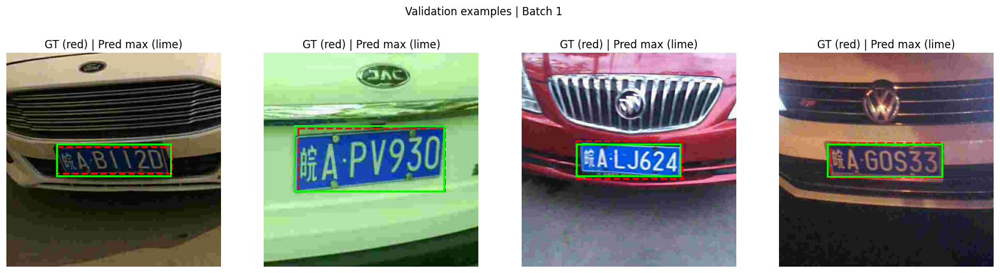

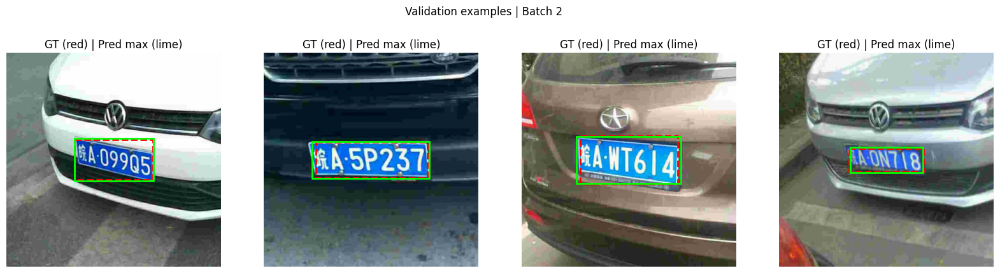

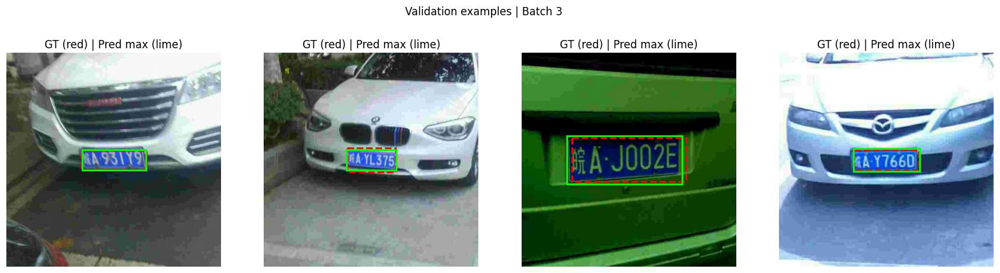

In [24]:
# Stampa delle metriche finali
last_epoch = len(train_losses)
last_loss = train_losses[-1] if train_losses else None
last_iou = avg_ious[-1] if avg_ious else None

print(f"Metriche di fine training:")
print(f" Epoch: {last_epoch}")
print(f" Train Loss: {last_loss:.4f}")
print(f" Avg IoU (> {iou_threshold}): {last_iou:.4f}")

# Esempi di validazione post-training
model.eval()
num_batches_to_show = 3

print(f"\nEsempi di validazione")

with torch.no_grad():
    batch_counter = 0
    for images, targets in val_loader:
        images = [img.to(device) for img in images]
        outputs = model(images)

        batch_size = len(images)
        fig, axs = plt.subplots(1, batch_size, figsize=(5 * batch_size, 5))
        if batch_size == 1:
            axs = [axs]

        for idx in range(batch_size):
            img = images[idx].cpu()
            output = outputs[idx]
            gt = targets[idx]

            axs[idx].imshow(TF.to_pil_image(img))
            axs[idx].axis('off')

            # Ground truth boxes (rosse)
            for box in gt['boxes'].cpu().numpy():
                x_min, y_min, x_max, y_max = box
                axs[idx].add_patch(plt.Rectangle(
                    (x_min, y_min), x_max - x_min, y_max - y_min,
                    edgecolor='red', facecolor='none', linewidth=2, linestyle='--'
                ))

            # Predicted box with max confidence (verde)
            pred_boxes = output['boxes'].cpu().numpy()
            scores = output['scores'].cpu().numpy()
            if len(pred_boxes) > 0:
                max_idx = scores.argmax()
                box = pred_boxes[max_idx]
                x_min, y_min, x_max, y_max = box
                axs[idx].add_patch(plt.Rectangle(
                    (x_min, y_min), x_max - x_min, y_max - y_min,
                    edgecolor='lime', facecolor='none', linewidth=2
                ))

            axs[idx].set_title(f"GT (red) | Pred max (lime)")

        plt.suptitle(f"Validation examples | Batch {batch_counter+1}")
        plt.show()

        batch_counter += 1
        if batch_counter == num_batches_to_show:
            break


Esecuzione Test: ccpd_blur.csv
Starting test:


Test Evaluation:   0%|          | 0/5153 [00:00<?, ?it/s]

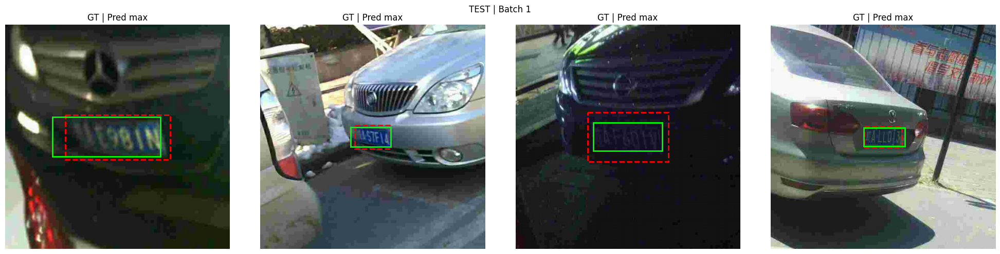

Test Evaluation:   0%|          | 1/5153 [00:01<1:44:30,  1.22s/it]

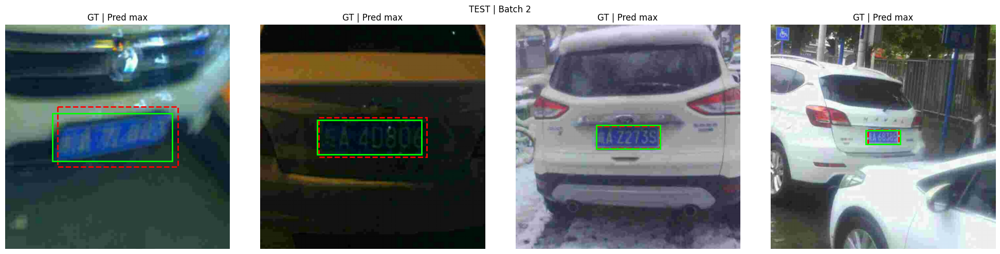

Test Evaluation:   0%|          | 2/5153 [00:01<1:14:14,  1.16it/s]

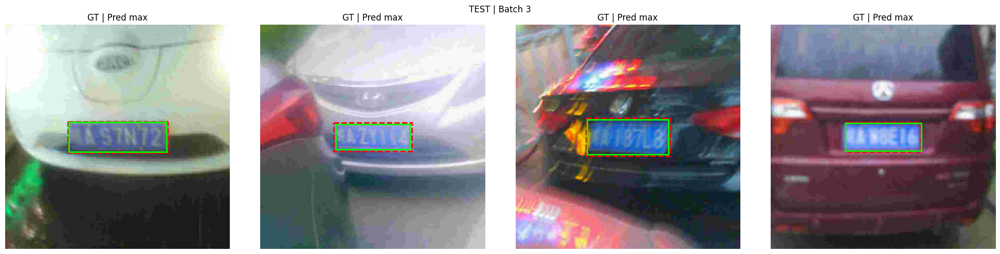

Test Evaluation: 100%|██████████| 5153/5153 [12:37<00:00,  6.80it/s]


Average IoU (IoU ≥ 0.7): 0.8530
Recall-like (GT matched with IoU ≥ 0.7): 0.7995
Inference time: 757.48 seconds
Images processed: 20611
FPS (inference): 27.21
Esecuzione Test: ccpd_challenge.csv
Starting test:


Test Evaluation:   0%|          | 0/12501 [00:00<?, ?it/s]

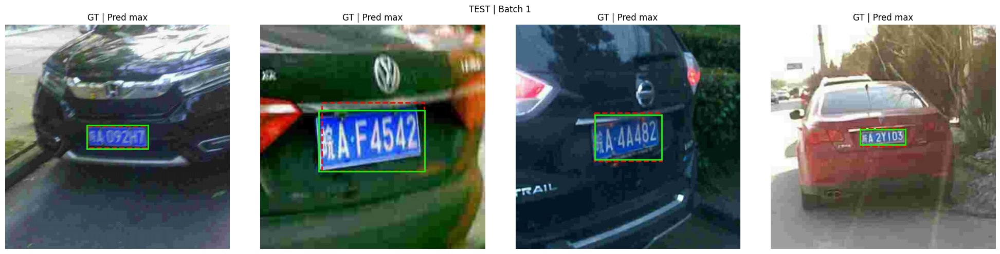

Test Evaluation:   0%|          | 1/12501 [00:01<4:13:25,  1.22s/it]

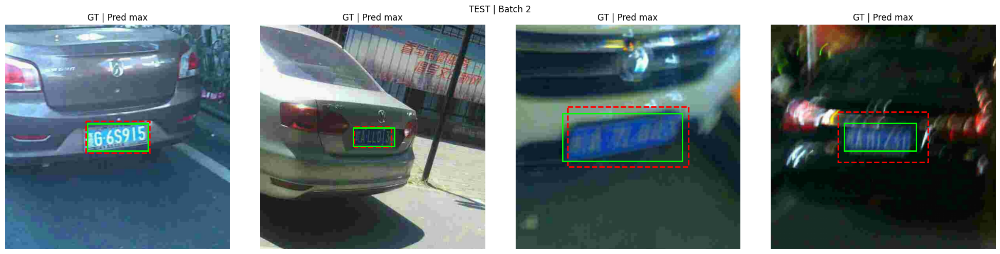

Test Evaluation:   0%|          | 2/12501 [00:02<4:00:46,  1.16s/it]

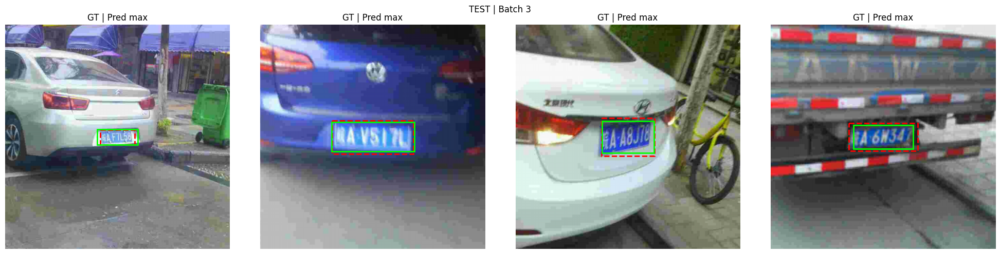

Test Evaluation: 100%|██████████| 12501/12501 [30:42<00:00,  6.78it/s]


Average IoU (IoU ≥ 0.7): 0.8511
Recall-like (GT matched with IoU ≥ 0.7): 0.8799
Inference time: 1843.01 seconds
Images processed: 50003
FPS (inference): 27.13
Esecuzione Test: ccpd_db.csv
Starting test:


Test Evaluation:   0%|          | 0/2533 [00:00<?, ?it/s]

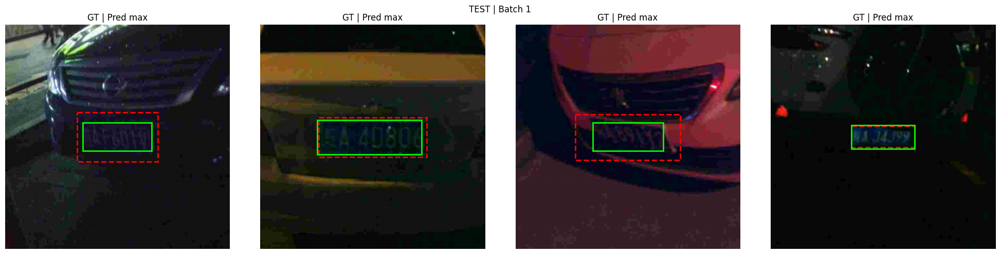

Test Evaluation:   0%|          | 1/2533 [00:01<48:23,  1.15s/it]

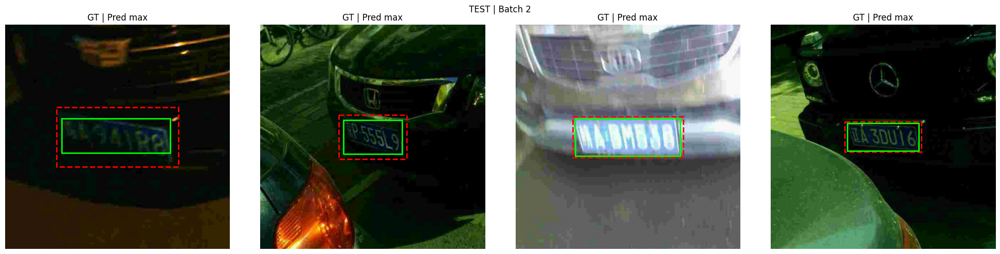

Test Evaluation:   0%|          | 2/2533 [00:01<35:09,  1.20it/s]

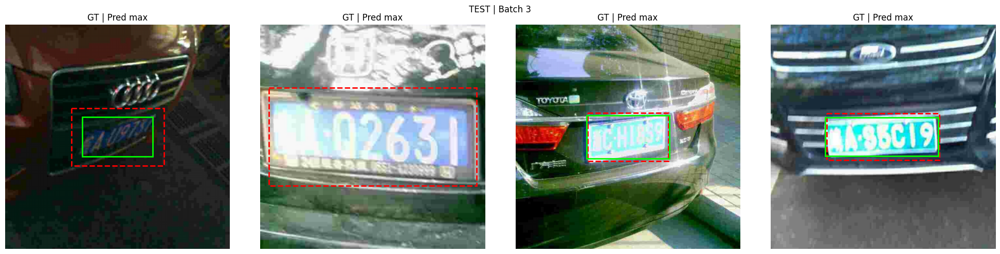

Test Evaluation: 100%|██████████| 2533/2533 [06:14<00:00,  6.77it/s]


Average IoU (IoU ≥ 0.7): 0.8297
Recall-like (GT matched with IoU ≥ 0.7): 0.6442
Inference time: 374.13 seconds
Images processed: 10132
FPS (inference): 27.08
Esecuzione Test: ccpd_fn.csv
Starting test:


Test Evaluation:   0%|          | 0/5242 [00:00<?, ?it/s]

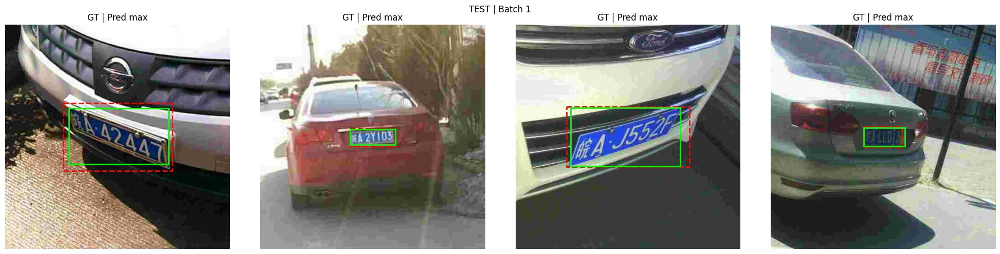

Test Evaluation:   0%|          | 1/5242 [00:01<1:47:39,  1.23s/it]

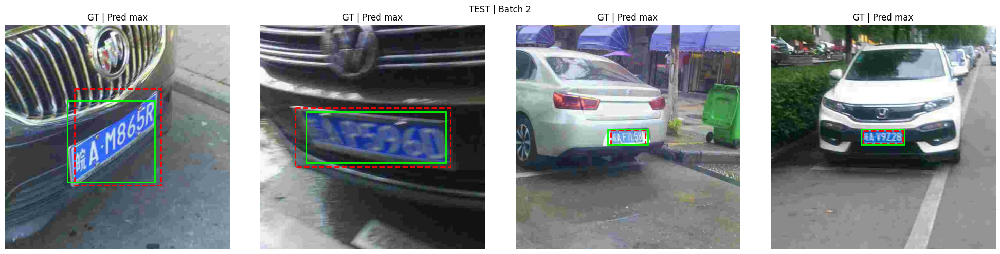

Test Evaluation:   0%|          | 2/5242 [00:01<1:18:17,  1.12it/s]

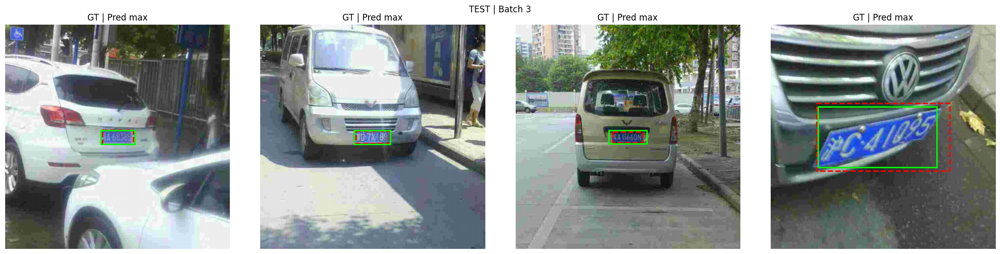

Test Evaluation: 100%|██████████| 5242/5242 [12:52<00:00,  6.79it/s]


Average IoU (IoU ≥ 0.7): 0.8238
Recall-like (GT matched with IoU ≥ 0.7): 0.7828
Inference time: 772.09 seconds
Images processed: 20967
FPS (inference): 27.16
Esecuzione Test: ccpd_rotate.csv
Starting test:


Test Evaluation:   0%|          | 0/2514 [00:00<?, ?it/s]

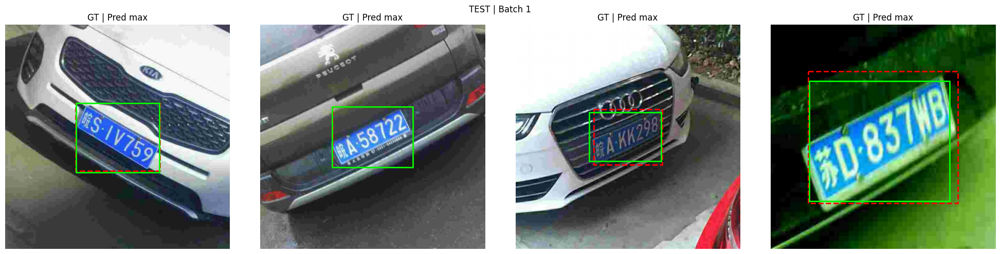

Test Evaluation:   0%|          | 1/2514 [00:01<51:22,  1.23s/it]

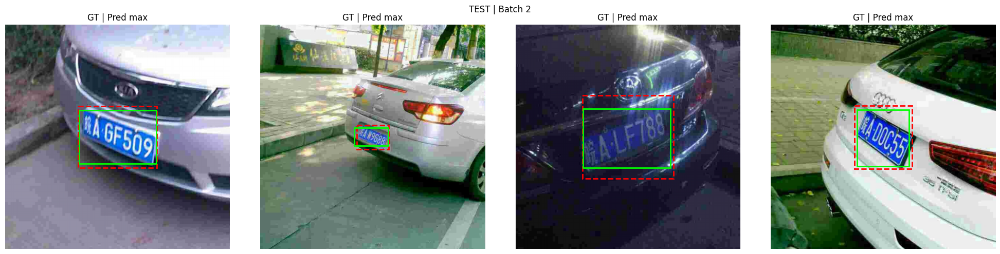

Test Evaluation:   0%|          | 2/2514 [00:01<37:34,  1.11it/s]

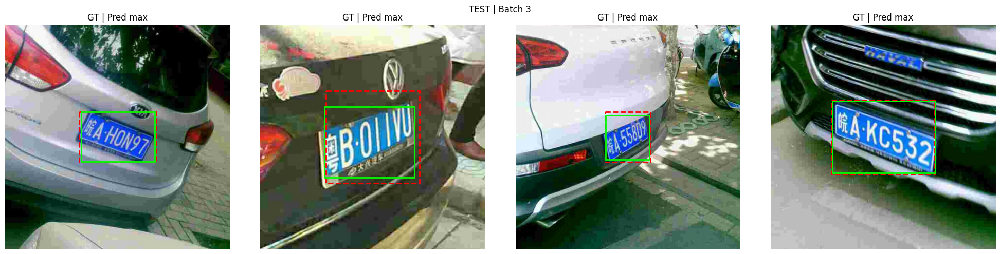

Test Evaluation: 100%|██████████| 2514/2514 [06:12<00:00,  6.75it/s]


Average IoU (IoU ≥ 0.7): 0.8447
Recall-like (GT matched with IoU ≥ 0.7): 0.9456
Inference time: 372.54 seconds
Images processed: 10053
FPS (inference): 26.99
Esecuzione Test: ccpd_tilt.csv
Starting test:


Test Evaluation:   0%|          | 0/7554 [00:00<?, ?it/s]

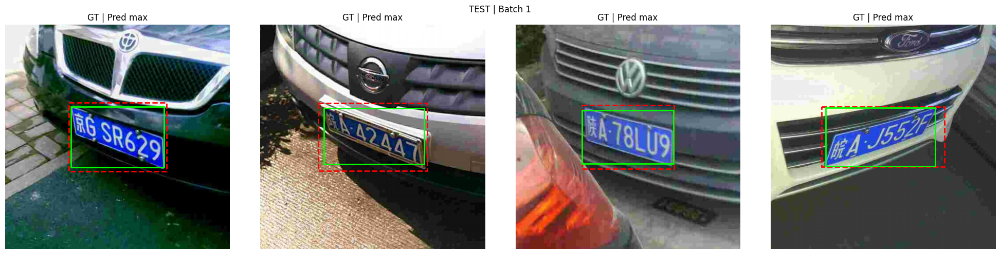

Test Evaluation:   0%|          | 1/7554 [00:01<2:30:44,  1.20s/it]

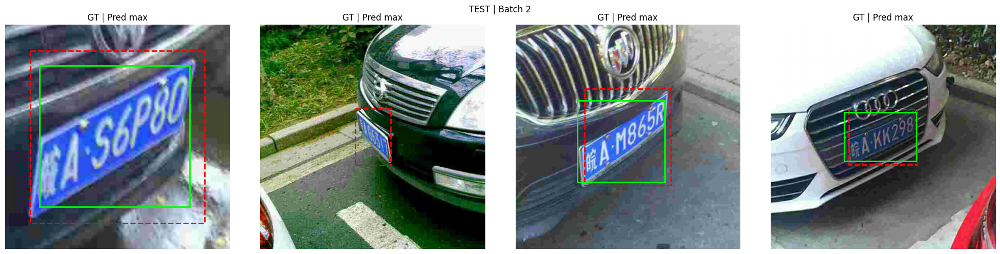

Test Evaluation:   0%|          | 2/7554 [00:01<1:58:24,  1.06it/s]

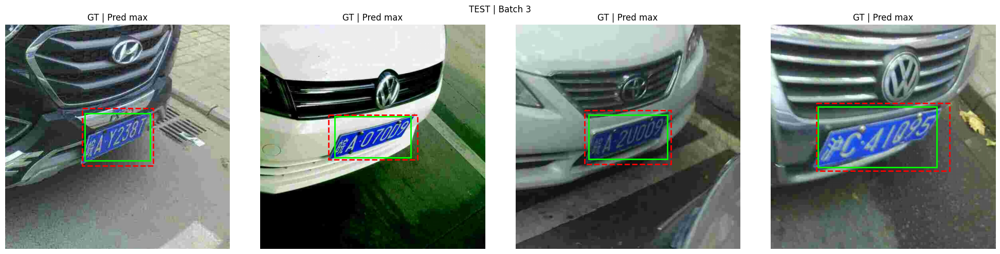

Test Evaluation: 100%|██████████| 7554/7554 [18:33<00:00,  6.78it/s]


Average IoU (IoU ≥ 0.7): 0.8064
Recall-like (GT matched with IoU ≥ 0.7): 0.8038
Inference time: 1113.40 seconds
Images processed: 30216
FPS (inference): 27.14
Esecuzione Test: ccpd_weather.csv
Starting test:


Test Evaluation:   0%|          | 0/2500 [00:00<?, ?it/s]

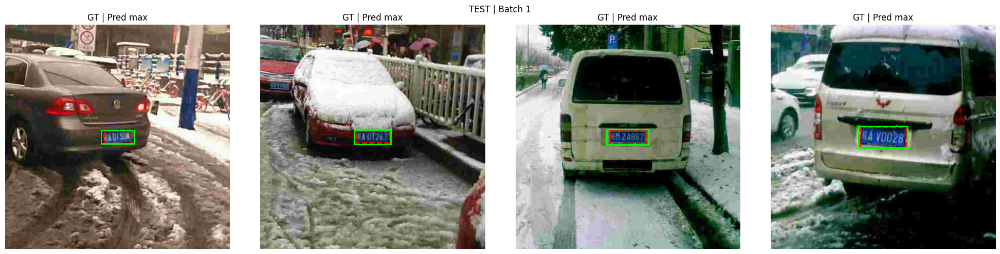

Test Evaluation:   0%|          | 1/2500 [00:01<51:26,  1.24s/it]

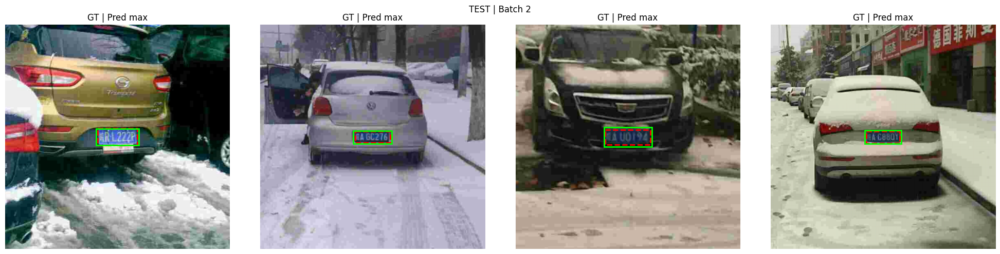

Test Evaluation:   0%|          | 2/2500 [00:01<37:27,  1.11it/s]

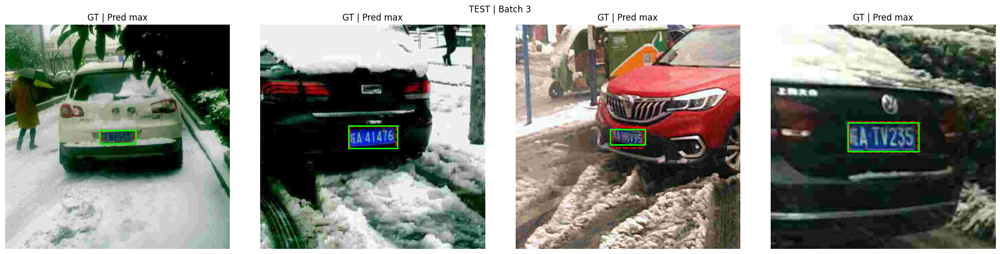

Test Evaluation: 100%|██████████| 2500/2500 [06:08<00:00,  6.79it/s]

Average IoU (IoU ≥ 0.7): 0.8927
Recall-like (GT matched with IoU ≥ 0.7): 0.9812
Inference time: 368.33 seconds
Images processed: 9999
FPS (inference): 27.15


In [26]:
# Funzione per valutare il modello su un DataLoader di test

def evaluate_model_on_test_loader(model, test_loader, iou_threshold):
    model.eval()
    total_iou_test = 0
    num_boxes_test = 0
    matched_gt = 0
    total_gt = 0
    num_images_test = 0

    print("Starting test:")

    if torch.cuda.is_available():
        for images, _ in test_loader:
            images = [img.to(device) for img in images]
            _ = model(images)
            break
        torch.cuda.synchronize()

    start_time = time.perf_counter()

    with torch.no_grad():
        batch_counter = 0

        for images, targets in tqdm(test_loader, desc="Test Evaluation"):
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            outputs = model(images)

            num_images_test += len(images)

            for t, o in zip(targets, outputs):
                gt_boxes = t['boxes'].cpu().numpy()
                pred_boxes = o['boxes'].cpu().numpy()

                for gt_box in gt_boxes:
                    ious = [compute_iou(gt_box, pred_box) for pred_box in pred_boxes]
                    total_gt += 1
                    if ious:
                        max_iou = max(ious)
                        if max_iou >= iou_threshold:
                            total_iou_test += max_iou
                            num_boxes_test += 1
                            matched_gt += 1

            if batch_counter < 3:
                batch_size = len(images)
                fig, axs = plt.subplots(1, batch_size, figsize=(5 * batch_size, 5))
                if batch_size == 1:
                    axs = [axs]

                for idx in range(batch_size):
                    img = images[idx].cpu()
                    output = outputs[idx]
                    gt = targets[idx]

                    axs[idx].imshow(TF.to_pil_image(img))
                    axs[idx].axis('off')

                    gt_boxes = gt['boxes'].cpu().numpy()
                    for box in gt_boxes:
                        x_min, y_min, x_max, y_max = box
                        axs[idx].add_patch(plt.Rectangle(
                            (x_min, y_min), x_max - x_min, y_max - y_min,
                            edgecolor='red', facecolor='none', linewidth=2, linestyle='--'
                        ))

                    pred_boxes = output['boxes'].cpu().numpy()
                    scores = output['scores'].cpu().numpy()
                    if len(pred_boxes) > 0:
                        max_idx = scores.argmax()
                        box = pred_boxes[max_idx]
                        x_min, y_min, x_max, y_max = box
                        axs[idx].add_patch(plt.Rectangle(
                            (x_min, y_min), x_max - x_min, y_max - y_min,
                            edgecolor='lime', facecolor='none', linewidth=2
                        ))

                    axs[idx].set_title("GT | Pred max")

                plt.suptitle(f"TEST | Batch {batch_counter+1}")
                plt.tight_layout()
                plt.show()

                batch_counter += 1

    if torch.cuda.is_available():
        torch.cuda.synchronize()
    elapsed_time = time.perf_counter() - start_time
    fps = num_images_test / elapsed_time if elapsed_time > 0 else 0

    avg_iou_test = total_iou_test / num_boxes_test if num_boxes_test else 0.0
    recall_like = matched_gt / total_gt if total_gt else 0.0

    print(f"Average IoU (IoU ≥ {iou_threshold}): {avg_iou_test:.4f}")
    print(f"Recall-like (GT matched with IoU ≥ {iou_threshold}): {recall_like:.4f}")
    print(f"Inference time: {elapsed_time:.2f} seconds")
    print(f"Images processed: {num_images_test}")
    print(f"FPS (inference): {fps:.2f}")


# Test su tutti i CSV

csv_dir = "."
csv_files = [
    "ccpd_blur.csv",
    "ccpd_challenge.csv",
    "ccpd_db.csv",
    "ccpd_fn.csv",
    "ccpd_rotate.csv",
    "ccpd_tilt.csv",
    "ccpd_weather.csv"
]

for csv_file in csv_files:
    print(f"Esecuzione Test: {csv_file}")
    
    test_df = pd.read_csv(os.path.join(csv_dir, csv_file))
    
    test_dataset = CCPDFRCNNDataset(
        test_df,
        dataset_path,
        transformer=CCPDTransformCenteredFRCNN(dataset_path),
        augment=False
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=4, 
        shuffle=False,
        num_workers=num_workers,
        collate_fn=collate_fn
    )

    evaluate_model_on_test_loader(model, test_loader, iou_threshold)
